# Crime in SLC 2015: Time & Spatial Analysis

# 1. Project Overview

The police data of Salt Lake City is published each year and available to the public via the cities open source data website. Many residents of Salt Lake City have their own opinions about what crime happens and where it occurs in the city, however many people do not look at the data that is being published. The goal of this project was to create a tool for people to form their own inferences on the city based on the actual data. We tried to achieve this goal by creating simple visualizations of police data so people could interpret it quickly and draw meaningful conclusions. 

Various types of crimes were examined such as violent crime, petty crime, traffic stops, and accidents. The conclusions drawn from this analysis may help influence public policy decisions in the following ways:

   1. Help show where to allocate police resources to more vulnerable communities.
   2. Helps show the most dangerous intersections and roads.
   3. Provide the public with a greater understanding of where and when they may become victoms of various crime.
   4. Helps show where to provide more public funding to vulnerable neighborhoods.
   5. Provide valuable real estate information for home owners and buyers.


# 2. Data and Processing
The data utilized for this data set is a from SLCPD open data "calls for service". They partnered with the Open Data Initiative and the Data Driven Justice Committees which are committees supported by the White House and the President to allow for better research and policing across the nation.  

The Data for this set includes an X and Y grid based on an EPSG. EPSG stands for European Petroleum Survey Group. ESPG publishes a database of coordinate system information on locations around the world. The EPSG Geodetic Parameter Dataset is a collection of definitions of coordinate reference systems and coordinate transformations which may be national, global, or local in form. Values of the data coordinate grid were matched with an identical grid referenced on spatialreference.org which contains meta data information on all EPSG codes. The correct grid projection was then determined and converted to standard latitude and longitudes with a simple linear mapping. 

Sources: Google :)


In [1]:
import pandas as pd
import datetime
import io
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
from pyproj import Proj, transform
import numpy as np
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster
%matplotlib inline
import re
import statsmodels.formula.api as sm

In [2]:
main_data=pd.read_csv("calls2015.csv")

In [3]:
data=main_data
data.columns=['key','date','type','location','trans','zone','grid','county','xcord','ycord']
data.tail()

,key,date,type,location,trans,zone,grid,county,xcord,ycord
246907,SL2015246984,01/01/2016 12:00:00 AM,TRESPASSING/UNWANTED - IND/SMALL GROUP,15XX W NORTH TEMPLE ST ...,PUB PEACE - SUSPICIOUS ACTIVITY (VEH/PERSON),Z1,112.0,2.0,1880101.0,888654.0
246908,SL2015246535,12/31/2015 12:00:00 AM,VEHICLE THEFT,4XX S CHEYENNE ST ...,STOLEN VEH - PASSENGER VEH,Z2,121.0,2.0,1879991.0,884174.0
246909,SL2015247053,01/01/2016 12:00:00 AM,TRAFFIC STOP,3XX S MAIN ST ...,ESCAPE - WARRANTS ALL IN STATE,Z3,133.0,4.0,1891889.0,884493.0
246910,SL2015246818,01/02/2016 12:00:00 AM,SPECIAL NOTIFICATIONS,9XX W 300 N ...,PUB ORD - POLICE ASSISTANCE,Z1,112.0,1.0,1884718.0,889994.0
246911,SL2015246728,12/31/2015 12:00:00 AM,ADMINISTRATIVE INFORMATION,12XX E SOUTH TEMPLE ST ...,PUB ORD - LOST PROPERTY,Z4,141.0,3.0,1901930.0,887637.0


In [4]:
data['date']=pd.to_datetime(data['date'],format='%m/%d/%Y %I:%M:%S %p',errors='coerce')
data=data.sort_values(by='date')
data=data.reset_index()

# 2.1 Grid Projection EPSG

Through spatialreference.org it was determined that EPSG 32043 matched the coordinate grid utilized for this data set. From this grid it was converted to EPSG 4326 which is a widely used standard for latitude and longitude. We also validated that this is the correct ESPG code and that the provided (x,y) coordinates were linear by comparing the calculated latitude and longitude with the addresses in the locations column.

In [5]:
#Transforming the given (x,y) -> (lat,long)
inProj = Proj(init='epsg:32043',preserve_units=True)#### use 32043
outProj = Proj(init='epsg:4326')
x1,y1 =  np.array(data['xcord']),np.array(data['ycord'])
x2,y2 = transform(inProj,outProj,x1,y1)


In [6]:
#creating pandas dataframes
x1=pd.DataFrame(x1)
x2=pd.DataFrame(x2)
y1=pd.DataFrame(y1)
y2=pd.DataFrame(y2)

In [7]:
lat_long=pd.concat([x2,y2],axis=1)
lat_long.columns=['long','lat']

In [8]:
#Testing length
print(len(lat_long)==len(data))

True


In [9]:
#caution only run this once
data=pd.concat([data,lat_long],axis=1)

In [10]:
##### We want to ignore data that's outside of the city...
### The bounds of the parts of SLC we care about are more or less from 5600 W - 3200 E and 3300S - 2300N
### Using google maps we have 5600W = -112.01302 long, 3200 E 111.47313 long
### 3300 S = 40.699684 lat, 2300 N = 40.816830

data=data[data["long"]>(-112.01302)]
data=data[data["long"]<(-111.47313)]
data=data[data["lat"]>(40.699684)]
data=data[data["lat"]<(40.816830)]

In [11]:
#using folium to visualize our data
#this also serves as a way to check the accuracy of our mapping

In [12]:
#WARNING this takes about 2 hours to run!!
m = folium.Map(location=(40.76,-111.897), zoom_start=12)
#centering map on SLC
marker_cluster = MarkerCluster().add_to(m)
#using Divisive Hierarchical clustering that's already in folium
for i in range(0,len(data)):
        folium.Marker(location=[data.iloc[i]['lat'], data.iloc[i]['long']],
              popup=('Call Type: ' + str(data.iloc[i]['type'])+
                     ' Date: ' +
                     (str(data.iloc[i]['date']).split())[0] +
                     '  Location: ' +
                     str(data.iloc[i]['location']))).add_to(marker_cluster)

        
m.save('AllDataMarkedCluster.html')

KeyboardInterrupt: 

In [13]:
#this map shows that we have not only have spatial accuracy, but also with at least within one city's block of percision.

# 3. Time Series Analysis

In this section we want to identify how crime changed over time in 2015. This allows for the determination of the most frequent times that police calls occur in Salt Lake City. 

First, we will start with all calls that occured regardless of type. 

In [14]:
calls_data=data['date'].value_counts()
calls_data=pd.DataFrame(calls_data)
calls_data=calls_data.reset_index()
calls_data.columns=['date','calls']
calls_data=calls_data.sort_values('date')
calls_data=calls_data[0:365]

Text(0.5,0,'Month')

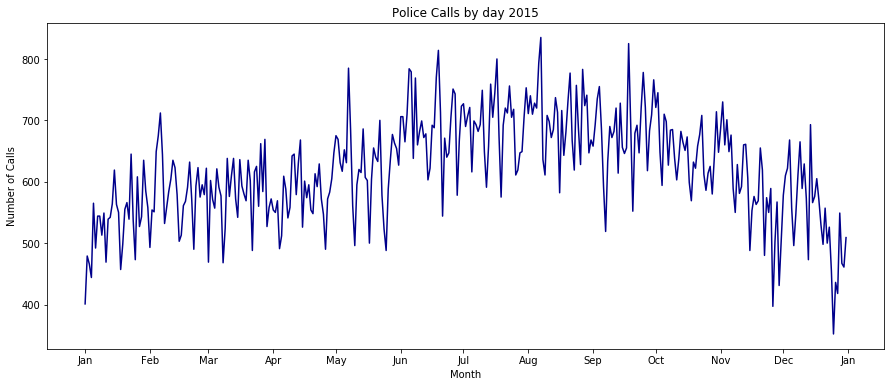

In [15]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(calls_data['date'],calls_data['calls'],color='darkblue')
ax.xaxis.set_major_locator(months)
ax.xaxis.set_major_formatter(monthsFmt)
plt.title("Police Calls by day 2015")
plt.ylabel('Number of Calls')
plt.xlabel('Month')


Top 50 most common types of police calls during 2015 are shown below. We're not sure what hold log means, but we just consider it uncategorized. Traffic stops are the most common related police incident. Trespassings, towings, and suspicious persons seem to be the most commonly reported 911 calls.

In [16]:
data['type'].value_counts()[0:50]

HOLD LOG                                    49844
TRAFFIC STOP                                23387
TRESPASSING/UNWANTED - IND/SMALL GROUP       8334
CAD TO CAD PD CODE                           7436
MISC BUSY STATUS                             5430
TOWING                                       5082
CELL 911 HANGUP                              4949
AGENCY ASSIST                                4876
SUSPICIOUS PERSON                            4762
HOLD LOG - TRANSFER                          4677
ESCAPE - WARRANTS ALL IN STATE               3846
VEHICLE THEFT INVESTIGATION                  3064
ATTEMPT TO LOCATE/BOLO                       2995
THEFT/LARCENY INVESTIGATION                  2959
TRAFFIC ACCIDENT ONLINE                      2881
THEFT/LARCENY                                2777
POLICE PROQA                                 2500
TRAFFIC ACCIDENT - NO INJURIES               2442
BURGLARY INVESTIGATION                       2327
MISCELLANEOUS - NON URGENT                   2099


There is quite a lot of analysis that can be done with data.  We will select a few call types that we find interesting.

# 3.1 Traffic Accidents Time Series

In [17]:
traffic_accidents_injuries=data[data['type'].isin(["TRAFFIC INCIDENT W/ INJURY"])]
traffic_accidents_noinjuries=data[data['type'].isin(["TRAFFIC ACCIDENT - NO INJURIES"])]

In [52]:
traffic_accidents=data[data['type'].isin(["TRAFFIC ACCIDENT - NO INJURIES", "TRAFFIC INCIDENT W/ INJURY"])]
traffic_accidents=traffic_accidents.groupby(['date'])['type'].value_counts()
traffic_accidents=pd.DataFrame(traffic_accidents)
traffic_accidents.columns=['calls']
traffic_accidents=traffic_accidents.reset_index()
traffic_accidents=traffic_accidents.sort_values('date')

Text(0.5,0,'Month')

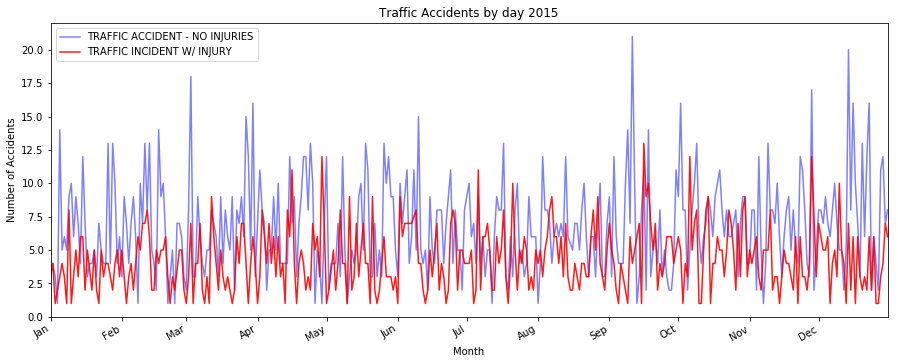

In [181]:
grouped_cause=traffic_accidents.groupby(['type'])
fig,ax=plt.subplots(figsize=(15,6))
colors = {'TRAFFIC INCIDENT W/ INJURY':'red', 'TRAFFIC ACCIDENT - NO INJURIES':'blue'}
alpha={'TRAFFIC INCIDENT W/ INJURY':.9, 'TRAFFIC ACCIDENT - NO INJURIES':.5}
for i,group in grouped_cause: 
    group.plot('date','calls',label=i,ax=ax,color=colors[i],alpha=alpha[i])
ax.xaxis.set_major_locator(months)
ax.xaxis.set_major_formatter(monthsFmt)
plt.legend(loc='best')
plt.title("Traffic Accidents by day 2015")
plt.ylabel("Number of Accidents")
plt.xlabel('Month')



#plot shows interesting relation in summer more serious accidents. In winter less serious

Text(0.5,0,'Month')

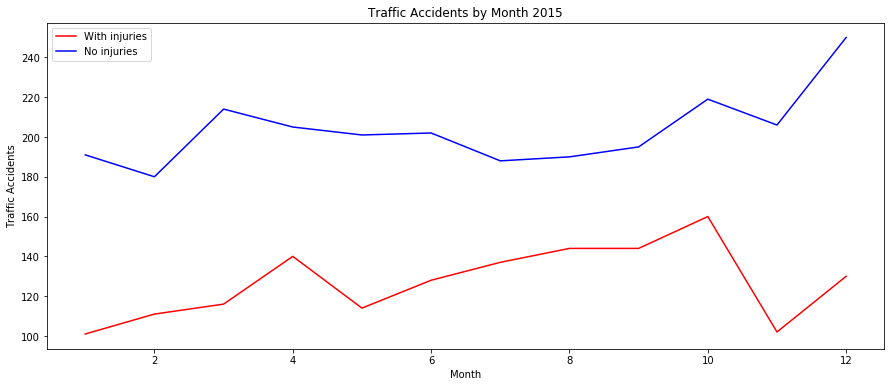

In [47]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(traffic_accidents_injuries['date'].groupby(traffic_accidents_injuries["date"].dt.month).count(),label='With injuries',color='red')
ax.plot(traffic_accidents_noinjuries['date'].groupby(traffic_accidents_noinjuries["date"].dt.month).count(),label='No injuries',color='blue')
plt.title("Traffic Accidents by Month 2015")
plt.ylabel('Traffic Accidents')
plt.legend(loc='best')
plt.xlabel('Month')

Certain days of the year have large spikes in the amount of traffic accidents. Traffic accidents without injuries appear to happen more in the winter time, likely due to hazardous road conditions from snow and ice. However, traffic accidents with injuries seem to occur most often in the summer and early fall. During the Spring and Fall the traffic accidents with injuries are higher suggesting that rain could be factor in causing traffic accidents with injuries.

# 3.2 Traffic Stops Time Series

In [19]:
traffic_stops=data[data['type'].isin(["TRAFFIC STOP"])]

In [20]:
traffic_stops_by_day=traffic_stops
traffic_stops_by_day=traffic_stops_by_day['date'].value_counts()
traffic_stops_by_day=pd.DataFrame(traffic_stops_by_day)
traffic_stops_by_day=traffic_stops_by_day.reset_index()
traffic_stops_by_day.columns=['date','calls']
traffic_stops_by_day=traffic_stops_by_day.sort_values('date')
traffic_stops_by_day=traffic_stops_by_day[0:365]


Text(0.5,0,'Month')

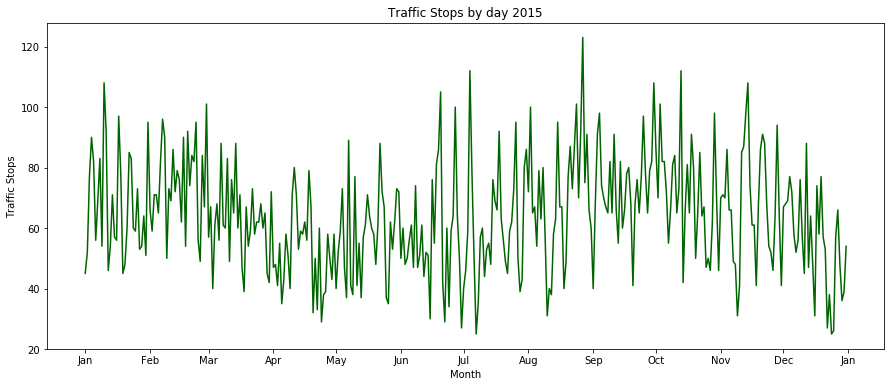

In [21]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(traffic_stops_by_day['date'],traffic_stops_by_day['calls'],color='darkgreen')
ax.xaxis.set_major_locator(months)
ax.xaxis.set_major_formatter(monthsFmt)
plt.title("Traffic Stops by day 2015")
plt.ylabel('Traffic Stops')
plt.xlabel('Month')

Text(0.5,0,'Day of Month')

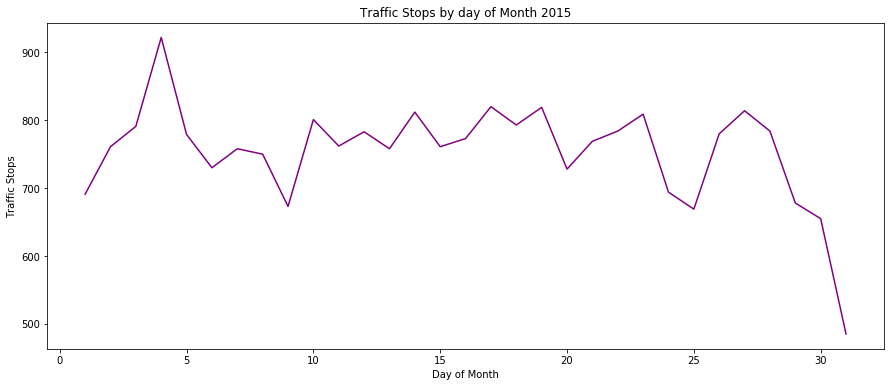

In [130]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(traffic_stops['date'].groupby(traffic_stops["date"].dt.day).count(),color='purple')
plt.title("Traffic Stops by day of Month 2015")
plt.ylabel('Traffic Stops')
plt.xlabel('Day of Month')

Traffic Stops are lowest in the summer and highest in the fall. They also have a distinct spike around the 4th day of each month.

# 3.3 Assaults Time Series

In [22]:
assaults=['ASSAULT (INDIVIDUAL OR SMALL GROUP)','PHYSICAL (FIGHT) LARGE GROUP','ASSAULT (LARGE GROUP) W/ CLUB','ASSAULT - SIMPLE ASSAULT','PHYSICAL (FIGHT) SMALL GROUP W/ KNIFE','ASSAULT INVESTIGATION','ASSAULT (INDIVIDUAL/SMALL GROUP) W/ KNIFE','ASSAULT INVESTIGATION W/ CLUB','ASSAULT/ MULTIPLE WEAPONS','PHYSICAL (FIGHT) W/ CLUB','ASSAULT (LARGE GROUP) W/ KNIFE','AGG ASSAULT - NON FAMILY ID WEAPON','ASSAULT - INTIMIDATION/STALKING','PHYSICAL (FIGHT) W/ KNIFE','ASSAULT INVESTIGATION W/ OTHER WEAPON','PHYSICAL (FIGHT) SMALL GROUP W/ OTHER WEAPON','PHYSICAL (FIGHT) W/ GUN','ASSAULT (INDIVIDUAL/SMALL GROUP) W/ OTHER WEAPON','ASSAULT (LARGE) W/ OTHER WEAPON','ASSAULT (INDIVIDUAL/SMALL GROUP) W/ CLUB']

In [23]:
assaults_calls=data[data['type'].isin(assaults)]

In [25]:
assaults=['ASSAULT (INDIVIDUAL OR SMALL GROUP)','PHYSICAL (FIGHT) LARGE GROUP','ASSAULT (LARGE GROUP) W/ CLUB','ASSAULT - SIMPLE ASSAULT','PHYSICAL (FIGHT) SMALL GROUP W/ KNIFE','ASSAULT INVESTIGATION','ASSAULT (INDIVIDUAL/SMALL GROUP) W/ KNIFE','ASSAULT INVESTIGATION W/ CLUB','ASSAULT/ MULTIPLE WEAPONS','PHYSICAL (FIGHT) W/ CLUB','ASSAULT (LARGE GROUP) W/ KNIFE','AGG ASSAULT - NON FAMILY ID WEAPON','ASSAULT - INTIMIDATION/STALKING','PHYSICAL (FIGHT) W/ KNIFE','ASSAULT INVESTIGATION W/ OTHER WEAPON','PHYSICAL (FIGHT) SMALL GROUP W/ OTHER WEAPON','PHYSICAL (FIGHT) W/ GUN','ASSAULT (INDIVIDUAL/SMALL GROUP) W/ OTHER WEAPON','ASSAULT (LARGE) W/ OTHER WEAPON','ASSAULT (INDIVIDUAL/SMALL GROUP) W/ CLUB']
assaults=data[data['type'].isin(assaults)]
assaults=assaults['date'].value_counts()
assaults=pd.DataFrame(assaults)
assaults=assaults.reset_index()
assaults.columns=['date','calls']
assaults=assaults.sort_values('date')
assaults=assaults[0:365]

In [26]:
sexual_assault_calls=data[data['type'].isin(['SEX ASSAULT - FREE TEXT','SEXUAL ASSAULT ON ADULT INVESTIGATION','SEX ASSAULT - RAPE STRONGARM','SEXUAL ASSAULT ON ADULT INVESTIGATION'])]

In [27]:
sexual_assault=data[data['type'].isin(['SEX ASSAULT - FREE TEXT','SEXUAL ASSAULT ON ADULT INVESTIGATION','SEX ASSAULT - RAPE STRONGARM','SEXUAL ASSAULT ON ADULT INVESTIGATION'])]
sexual_assault=sexual_assault['date'].value_counts()
sexual_assault=pd.DataFrame(sexual_assault)
sexual_assault=sexual_assault.reset_index()
sexual_assault.columns=['date','calls']
sexual_assault=sexual_assault.sort_values('date')
sexual_assault=sexual_assault[0:365]

Text(0.5,0,'Month')

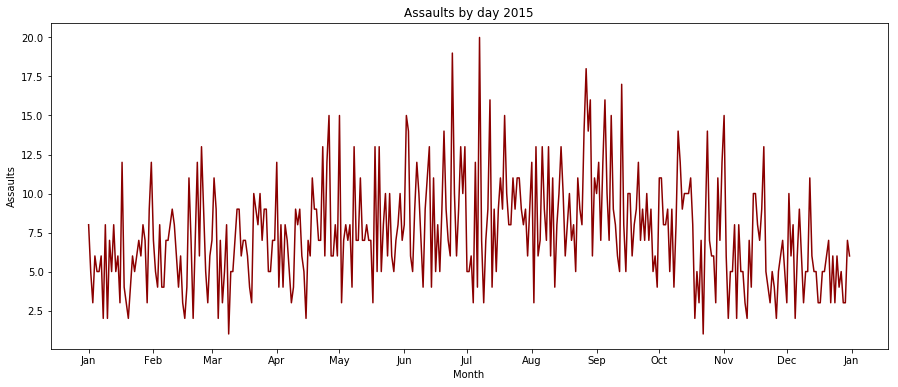

In [28]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(assaults['date'],assaults['calls'],color='darkred')
ax.xaxis.set_major_locator(months)
ax.xaxis.set_major_formatter(monthsFmt)
plt.title("Assaults by day 2015")
plt.ylabel('Assaults')
plt.xlabel('Month')

Text(0.5,0,'Month')

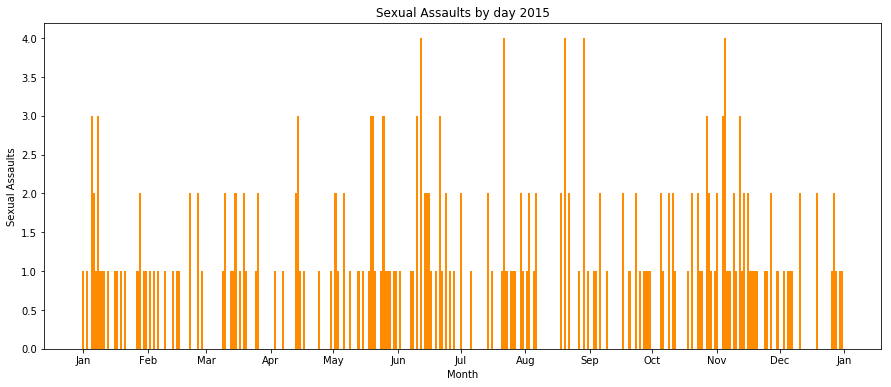

In [29]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.bar(sexual_assault['date'],sexual_assault['calls'],color='darkorange',width=1)
ax.xaxis.set_major_locator(months)
ax.xaxis.set_major_formatter(monthsFmt)
plt.title("Sexual Assaults by day 2015")
plt.ylabel('Sexual Assaults')
plt.xlabel('Month')

There are less reported assaults in the winter and the highest amount of assaults during the summer. There are various spikes throughout the year in both assaults and sexual assaults. Halloween and New years have notable spikes in the number of sexual assaults near them.

# 3.4 Noise Calls  Time Series

In [31]:
noise_calls=data[data['type'].isin(["LOUD PARTY/MUSIC", "OTHER NOISE COMPLAINT"])]
noise_calls_day=noise_calls.groupby(['date'])['type'].value_counts()
noise_calls_day=pd.DataFrame(noise_calls_day)
noise_calls_day.columns=['calls']
noise_calls_day=noise_calls_day.reset_index()
noise_calls_day=noise_calls_day.sort_values('date')

Text(0.5,0,'Month')

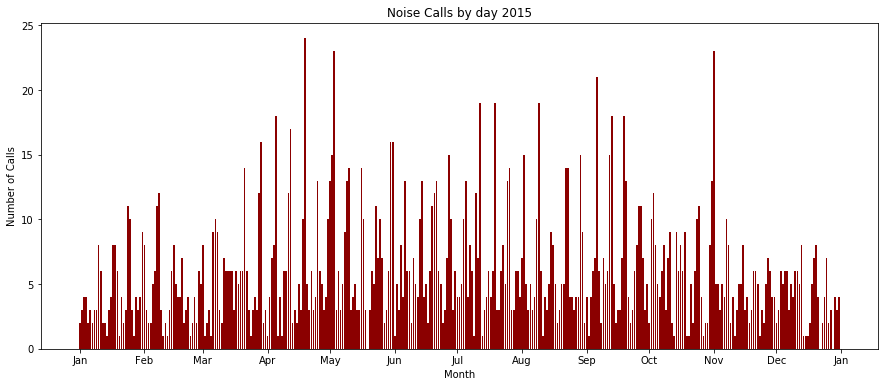

In [32]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.bar(noise_calls_day['date'],noise_calls_day['calls'],color='darkred')
ax.xaxis.set_major_locator(months)
ax.xaxis.set_major_formatter(monthsFmt)
plt.title("Noise Calls by day 2015")
plt.ylabel('Number of Calls')
plt.xlabel('Month')

On certain days there are significantly more noise complaints. There are less large spikes in the wintertime. Late April has many spikes possibly from the end of college finals.. Also around October 31 there are a large number of noise complaints. 

# 3.4 Burglaries Time Series

In [33]:
burglaries=data[data['type'].isin(["BURGLARY","BURGLARY INVESTIGATION"])]

Text(0.5,0,'Month')

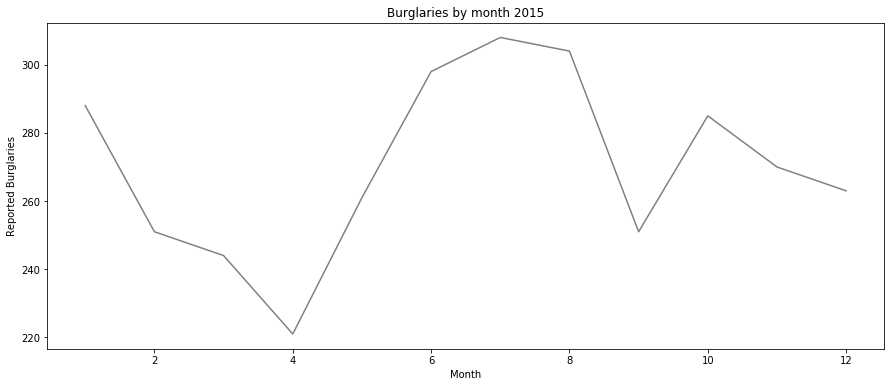

In [34]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(burglaries['date'].groupby(burglaries["date"].dt.month).count(),color='grey')
plt.title("Burglaries by month 2015")
plt.ylabel('Reported Burglaries')
plt.xlabel('Month')

In [35]:
burglaries_calls=burglaries
burglaries_calls=burglaries['date'].value_counts()
burglaries_calls=pd.DataFrame(burglaries_calls)
burglaries_calls=burglaries_calls.reset_index()
burglaries_calls.columns=['date','calls']
burglaries_calls=burglaries_calls.sort_values('date')
burglaries_calls=burglaries_calls[0:365]

Text(0.5,0,'Month')

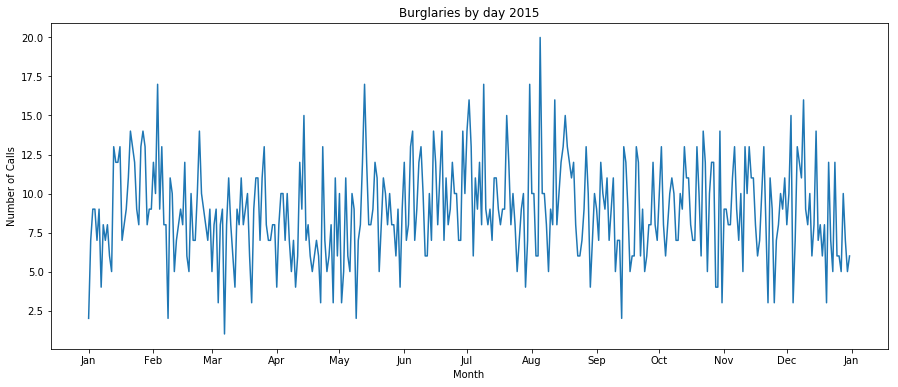

In [36]:
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(burglaries_calls['date'],burglaries_calls['calls'])
ax.xaxis.set_major_locator(months)
ax.xaxis.set_major_formatter(monthsFmt)
plt.title("Burglaries by day 2015")
plt.ylabel('Number of Calls')
plt.xlabel('Month')

Burglaries seem to occur more often in the summer. This may be from more people taking vacations during the summer leaving homes unoccupied. There seems to be no relation between specific holidays and burglaries.

# 3.5 Vehicle theft time Series

In [39]:
vehicle_theft=data[data['type'].isin(["VEHICLE THEFT INVESTIGATION"])]

Text(0.5,0,'Month')

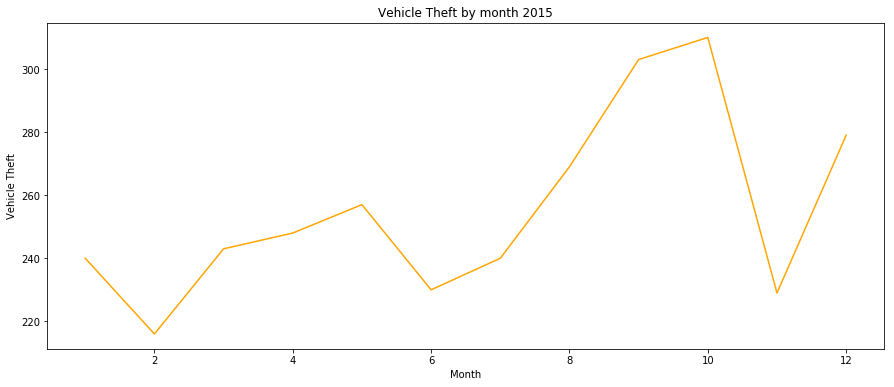

In [40]:
months = mdates.MonthLocator()  # every month
monthsFmt = mdates.DateFormatter('%b')
fig,ax = plt.subplots(figsize=(15,6))
ax.plot(vehicle_theft['date'].groupby(vehicle_theft["date"].dt.month).count(),color='orange')
plt.title("Vehicle Theft by month 2015")
plt.ylabel('Vehicle Theft')
plt.xlabel('Month')

Vehicle theft spikes dramatically during the Fall and early Winter. This may be due to people warming up their cars making them an easy target, or there being less daylight.

# 4. Spatial Analaysis

With the use of the powerful package Folium, a geospatial analysis was performed.

# 4.1 Traffic Accidents with injuries Geospatial analysis

For this analaysis Folium MarkerClusters are utilzied to find spatial clusters in Salt Lake City of Traffic Accidents. Interactive maps can be viewed as html files submitted with this analysis. 

In [48]:
map = folium.Map(location=(40.76,-111.897), zoom_start=12)

In [49]:
map_traffic = folium.Map(location=(40.76,-111.897), zoom_start=12)
marker_cluster_traffic = MarkerCluster().add_to(map_traffic)
for each in traffic_accidents_injuries.iterrows():
    folium.Marker(list((each[1]['lat'],each[1]['long'])),).add_to(marker_cluster_traffic)


In [50]:
ti=traffic_accidents_injuries
ti['lat'] = ti['lat'].astype(float)
ti['long'] = ti['long'].astype(float)
heat_ti = ti[['lat', 'long']]
heat_data_ti = [[row['lat'],row['long']] for index, row in heat_ti.iterrows()]
heat_map_traffic_accidents = folium.Map(location=(40.76,-111.897), zoom_start=12)
HeatMap(heat_data_ti,min_opacity=.4,radius=15).add_to(heat_map_traffic_accidents)


/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [152]:
heat_map_traffic_accidents.save('Traffic Accidents Heat map.html')

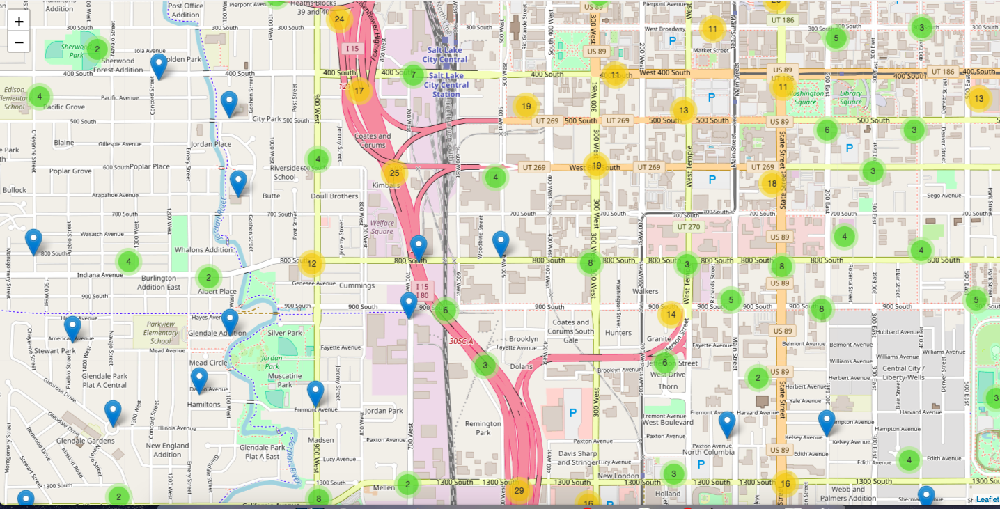

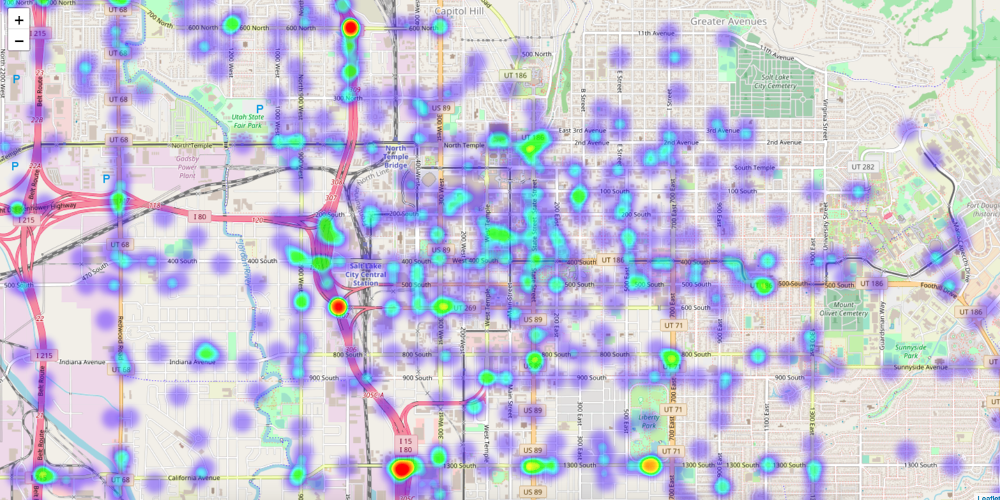

The most traffic accident with injury calls in Salt Lake City seem to be near I-15 north/southbound and 600 south. There is also a spike in traffic accidents with injuries on I-15 around 4th south and 600 north. Other dangerous sections include State Street 1300 south and 700 east 2100 south. The large amount of accidents can be attributed to the fact that these roads see the most traffic on any given day. Additionally, there are freeway overpasses and underpasses in these regions which might suggest driver are distracted by road signs or the changes in direction cause more accidents. However, this may be because when there are traffic accidents on interstates police are dispatched to the ramps rather than exact addresses on the freeway.

# 4.2 Noise Complaints Geospatial analysis

In [51]:
map_noise = folium.Map(location=(40.76,-111.897), zoom_start=12)
marker_cluster_noise = MarkerCluster().add_to(map_noise)
for each in noise_calls.iterrows():
    folium.Marker(list((each[1]['lat'],each[1]['long'])),).add_to(marker_cluster_noise)

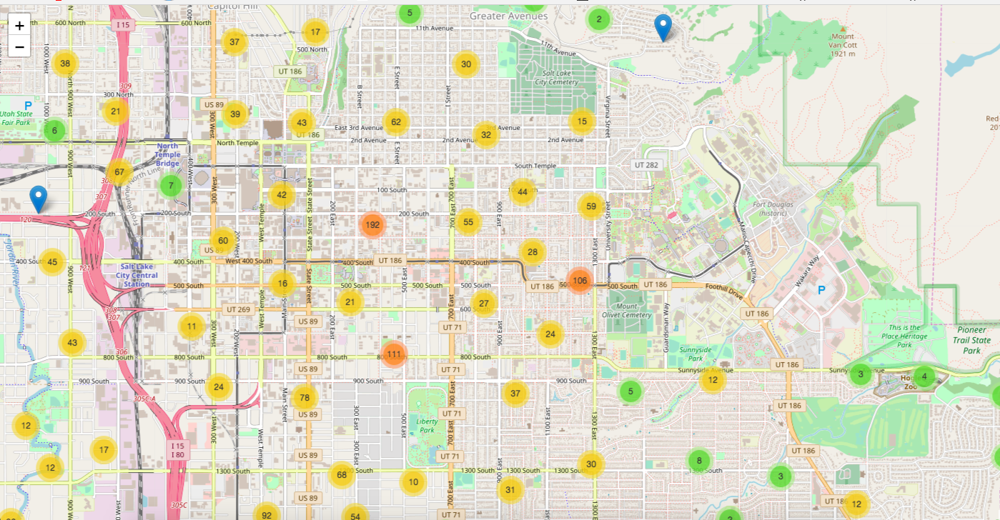

In [ ]:
map_noise.save('Noise Calls.html')

There are a lot of noise complaints near the University of Utah campus.. Also if you like things particularly quiet (or loud), please check this map before you move in somewhere in SLC; Some addresses have 10+ noise complaints within a year!

# 4.3 Burglaries Geospatial analysis

In [ ]:
map_burglaries = folium.Map(location=(40.76,-111.897), zoom_start=12)
marker_cluster_burglaries = MarkerCluster().add_to(map_burglaries)
for each in burglaries.iterrows():
    folium.Marker(list((each[1]['lat'],each[1]['long'])),).add_to(marker_cluster_burglaries)
    

In [ ]:
map_burglaries.save('Burglaries.html')

In [ ]:
b=burglaries
b['lat'] = b['lat'].astype(float)
b['long'] = b['long'].astype(float)
heat_b = b[['lat', 'long']]
heat_data_b = [[row['lat'],row['long']] for index, row in heat_b.iterrows()]

heat_map_burglaries = folium.Map(location=(40.76,-111.897), zoom_start=12)
HeatMap(heat_data_b,min_opacity=.4,radius=13).add_to(heat_map_burglaries)

In [ ]:
heat_map_burglaries.save('Burglaries Heat map.html')

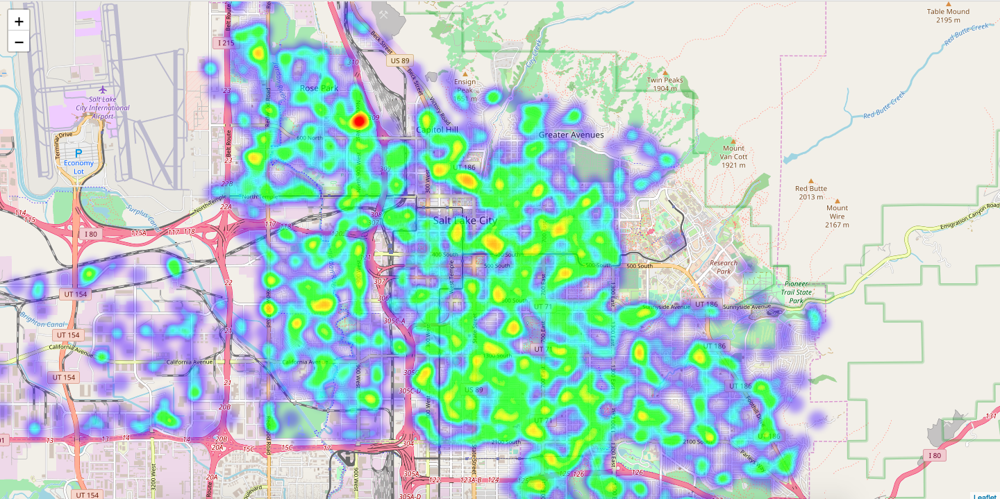

Burglaries are seen in the maps above. Burglaries seem to spike near apartment complexes. 

# 4.4  Vehicle theft Geospatial analaysis

In [ ]:
map_vehicle = folium.Map(location=(40.76,-111.897), zoom_start=12)
marker_cluster_vehicle = MarkerCluster().add_to(map_vehicle)
for each in vehicle_theft.iterrows():
    folium.Marker(list((each[1]['lat'],each[1]['long'])),).add_to(marker_cluster_vehicle)
  

In [ ]:
vt=vehicle_theft
vt['lat'] = vt['lat'].astype(float)
vt['long'] = vt['long'].astype(float)
heat_df = vt[['lat', 'long']]
heat_data = [[row['lat'],row['long']] for index, row in heat_df.iterrows()]
heat_map_vehicle = folium.Map(location=(40.76,-111.897), zoom_start=12)
HeatMap(heat_data,min_opacity=.2,radius=18).add_to(heat_map_vehicle)

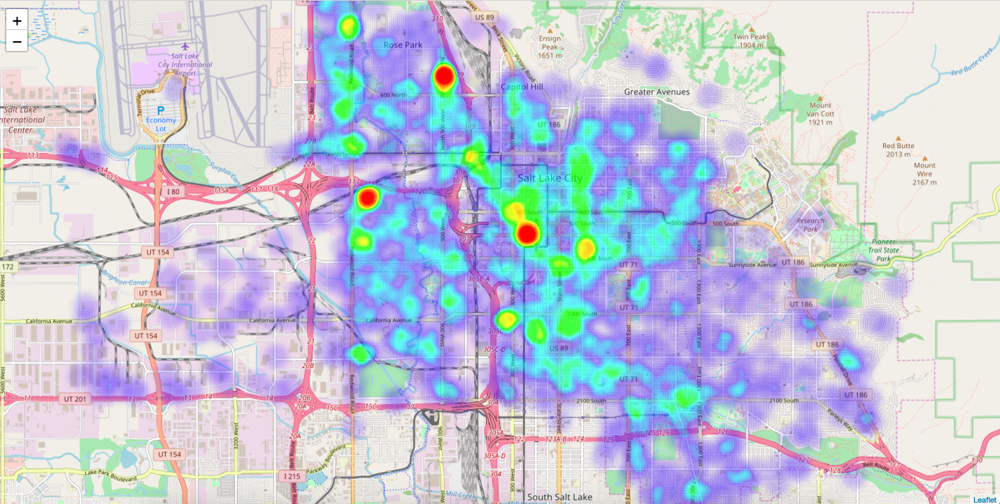

In [ ]:
map_vehicle.save('Vehicle Theft.html')

In [ ]:
heat_map_vehicle.save('Vehicle Theft Heat Map.html')

In [ ]:
vehicle_theft['location'].value_counts()[0:5]

The maps above show the vehicle theft. Significant spikes occur at and around apartment complexes and hotels.

# 4.5 Traffic Stops Geospatial analysis

In [ ]:
map_stops = folium.Map(location=(40.76,-111.897), zoom_start=12)
marker_cluster_stops = MarkerCluster().add_to(map_stops)
for each in traffic_stops.iterrows():
    folium.Marker(list((each[1]['lat'],each[1]['long'])),).add_to(marker_cluster_stops)
  

In [ ]:
map_stops.save('Traffic Stops.html')

In [ ]:
ts=traffic_stops
ts['lat'] = ts['lat'].astype(float)
ts['long'] = ts['long'].astype(float)
heat_ts = ts[['lat', 'long']]
heat_data_ts = [[row['lat'],row['long']] for index, row in heat_ts.iterrows()]
heat_map_traffic_stops = folium.Map(location=(40.76,-111.897), zoom_start=12)
HeatMap(heat_data_ts,min_opacity=.05,radius=8).add_to(heat_map_traffic_stops)

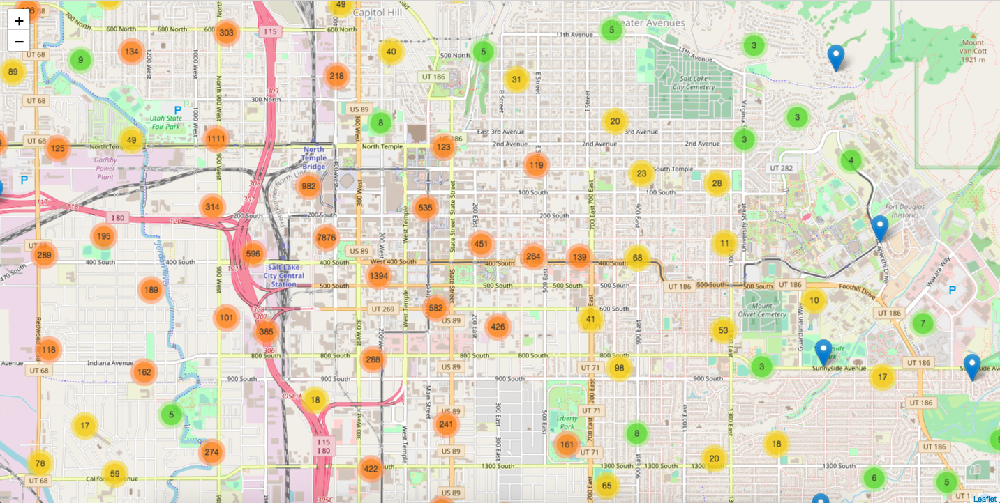

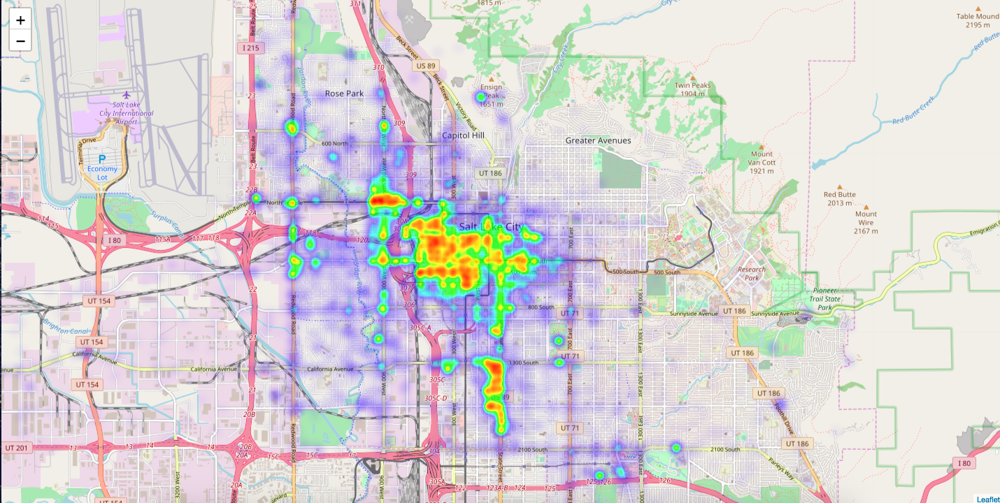

In [ ]:
traffic_stops['location'].value_counts()[0:5]

Traffic stops are most common in the downtown and there is a large cluster on state street south of downtown. There are also very large clusters near the homeless shelter and downtown police station.

# 4.6 Assaults Geospatial analysis

In [ ]:
map_assault = folium.Map(location=(40.76,-111.897), zoom_start=12)

marker_cluster_assault = MarkerCluster().add_to(map_assault)

for each in assaults_calls.iterrows():
    folium.Marker(list((each[1]['lat'],each[1]['long']))).add_to(marker_cluster_assault)

In [ ]:
a=assaults_calls
a['lat'] = a['lat'].astype(float)
a['long'] = a['long'].astype(float)
heat_a = a[['lat', 'long']]
heat_data_a = [[row['lat'],row['long']] for index, row in heat_a.iterrows()]
heat_map_assaults = folium.Map(location=(40.76,-111.897), zoom_start=12)
HeatMap(heat_data_a,min_opacity=.2,radius=18).add_to(heat_map_assaults)

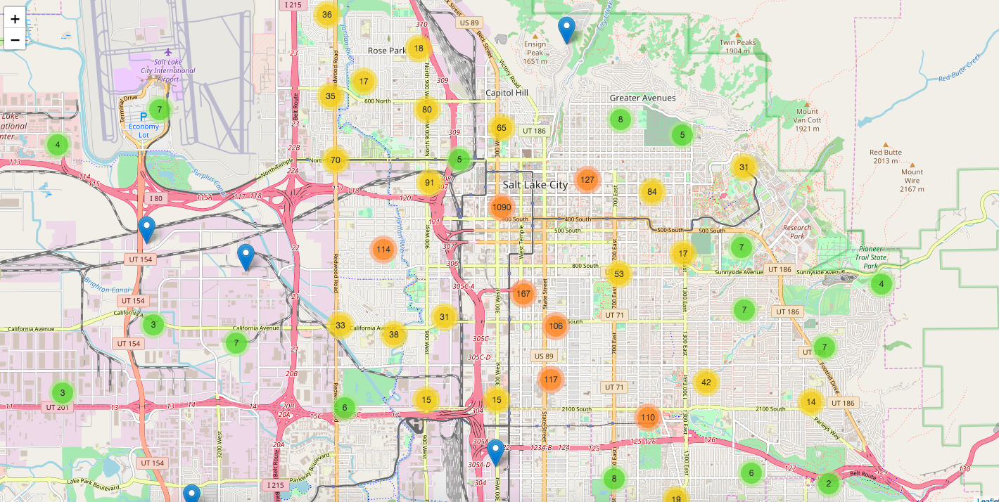

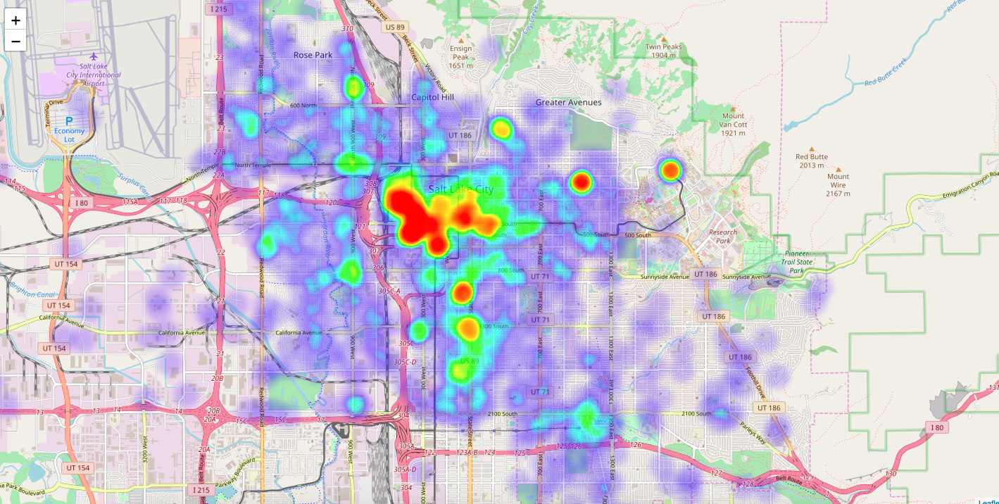

In [ ]:
heat_map_assaults.save("Assaults Heat Map.html")

In [ ]:
map_assault.save('Assaults.html')

Assault calls are reported most frequently downtown. There are also distinct clusters of assault calls at the University of Utah hospital, LDS hospital, and Salt Lake Regional Hospital. We think this is due to the hospital E.R's receiving walk-in patients who were possibly assaulted and requesting police to respond and investigate/complete a report. 

# 4.7 Sexual Assaults

In [ ]:
map_sexual_assault = folium.Map(location=(40.76,-111.897), zoom_start=12)

marker_cluster_sexual_assault = MarkerCluster().add_to(map_sexual_assault)

for each in sexual_assault_calls.iterrows():
    folium.Marker(list((each[1]['lat'],each[1]['long']))).add_to(marker_cluster_sexual_assault)

In [ ]:
map_sexual_assault.save("Sexual Assaults.html")

In [ ]:
sa=sexual_assault_calls
sa['lat'] = sa['lat'].astype(float)
sa['long'] = sa['long'].astype(float)
heat_sa = sa[['lat', 'long']]
heat_data_sa = [[row['lat'],row['long']] for index, row in heat_sa.iterrows()]
heat_map_sexual_assaults = folium.Map(location=(40.76,-111.897), zoom_start=12)
HeatMap(heat_data_sa,min_opacity=.2,radius=18).add_to(heat_map_sexual_assaults)

In [ ]:
heat_map_sexual_assaults.save('Sexual Assaults Heat Map.html')

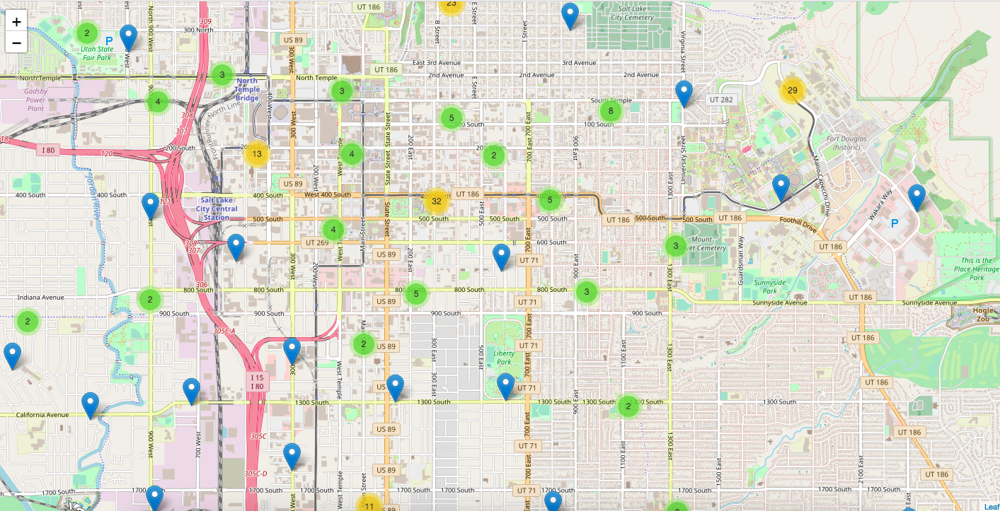

In [ ]:
sexual_assault_calls['location'].value_counts()[0:5]

Similar to assaults, sexual assaults calls are common at hospitals. This is likely because many sexual assault calls are being reported from hospitals and not because they are happening there. There is also a large cluster of calls near the downtown library. 

# Limitations

The conclusions drawn in this project are inferences made by the group members and might not actually reflect the whole truth. Furthermore, this data is only from the year 2015 and is only a reflection of the reported crime. The models and analysis of this project only tell us about patterns of reported crime, and not patterns of crime.

# 5. Conclusions

1) The busiest time for SLCPD based off of 911 calls is in the summer, peaking in August. The most common incident police respond to is traffic stops and the most commonly reported call is trespassing.

2) Traffic accidents with injuries spike in the spring and fall while, traffic acidents without injuries are highest in the winter. This is likely due to the meteorological cause of ice and snow in the winter, which causes more accidents, but people drive at slower speeds in snow, which contributes to lower injuries. However, during the spring and fall rain is the primary form of precipitation, which could lead to slick roads or hydroplaning. Drivers also travel at higher speeds when the weather is good and this contributes to an increase in traffic accidents with injuries. The spatial distribution of traffic accidents with injuries displays several distinct clusters. I-15 northbound/southbound around 600 south can be identified as the most dangerous stretch of road in Salt Lake City. Another large cluster of accidents with injuries is located around 600 north on I-15. The commonality in these sections of roads includes freeway exits/entrances and high speeds. Signs and merging traffic likely contribute to an increase in accidents in these areas, but is largely due to the fact that these are high traffic areas and experience thousands of cars daily. 

3) Traffic stops occur more frequently in the fall. There is no association between holidays and traffic stops. Traffic stops on average peak around the 4th or 5th of any month and then remain consistent for the rest of the month. A large amount of traffic stops occur downtown especially near the homeless shelter. There are also clusters around the police station and all along State Street south of downtown. This is likely due to an increased police presence as these are high traffic areas. Significant amount of traffic stops occur on the west side of downtown Salt Lake City where nearly 30% of all traffic stops occurred within 1/4 quarter mile grid between 4th and 2nd south and 400 west- 500 west.

4) Reported assaults and fighting have a higher frequency in the summer months. The spatial distribution of assaults is localized to downtown, while surrounding areas have many individual cases. There are distinct clusters of both assault calls and sexual assault calls at the University of Utah hospital, LDS hospital, and Salt Lake Regional Hospital. We think this may be due to the hospital E.R's receiving walk-in patients who were possibly assaulted and requesting police to respond and investigate/complete a report.  

5) Sexual assaults occur most commonly in the summer but also display some relation with holidays. Halloween and New Years have higher incidents of reported sexual assault compared to the rest of the year. Sexual Assaults clusters are found to be around hospitals and by the library downtown. At hospitals, investigations and reports may be filled from here and thus appear that way in the data. It is unlikely that the majority of sexual assault calls are happening here, as these are generally safe locations. Reported sexual assaults occur more frequently at locations such as parking lots and garages rather than residential neighborhoods.

6) During the springtime, noise complaints feature significantly more spikes. Noise calls are most likely occurring on the weekends, which is inferred from the graph as they are evenly spaced out through each month. Clusters of noise complaints are found near and around the neighborhoods surrounding the U, Westminster, and east of downtown. This is likely due the younger demographic who live closer to downtown and college kids that are partying close to their campuses. 

7) There are more peaks in burglaries in the summer and winter. One reason for this could be due to more people being on vacation, leaving unoccupied homes. Clusters of burglaries are identified with an increased frequency in and around apartment buildings. 

8) Vehicle theft spikes dramatically during the fall with a peak in October. Vehicle theft is lowest in the winter. Clusters of vehicle theft occur more frequently downtown and around apartment buildings parking lots. 

# 6. Recommendations

See these maps to decide where you want to be, where to avoid, and at what times in SLC! 